In [1]:
from __future__ import division


import tensorflow as tf
import tensorflow.keras.backend as K
from tensorflow.keras import regularizers
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dense, Dropout, Activation, Flatten
from tensorflow.keras.layers import Convolution2D, MaxPooling2D, ZeroPadding2D, GlobalAveragePooling2D, AveragePooling2D
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import ModelCheckpoint, CSVLogger
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.regularizers import l2
from tensorflow import keras
import numpy as np
import os


def create_model():
  
  inception = InceptionV3(input_shape=(299,299,3),include_top=False,weights='imagenet')
  inception.trainable=False
  base = inception.output
  
  x = GlobalAveragePooling2D(name='GlobalPooling')(base)
  #x = Dense(128,activation='relu')(x)
  x = Dense(128,activation='relu',name='Dense1')(x)
  x = Dropout(0.2,name='Dropout1')(x)
  x = Dense(128,activation='relu',name='Dense2')(x)
  x = Dropout(0.2,name='Dropout2')(x)

  predictions = Dense(101, activation='softmax',name='output')(x)

  model = Model(inputs=inception.input, outputs=predictions)
  model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
  return model

In [2]:
model = create_model()


87910968/87910968 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [3]:
model.summary()


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 299, 299,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 149, 149,  │        864 │ input_layer[0][0] │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 149, 149,  │         96 │ conv2d[0][0]      │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation          │ (None, 149, 149,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 147, 147,  │      9,216 │ activation[0][0]  │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 147, 147,  │         96 │ conv2d_1[0][0]    │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_1        │ (None, 147, 147,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 147, 147,  │     18,432 │ activation_1[0][… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 147, 147,  │        192 │ conv2d_2[0][0]    │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_2        │ (None, 147, 147,  │          0 │ batch_normalizat… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d       │ (None, 73, 73,    │          0 │ activation_2[0][… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 73, 73,    │      5,120 │ max_pooling2d[0]… │
│                     │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 73, 73,    │        240 │ conv2d_3[0][0]    │
│ (BatchNormalizatio… │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_3        │ (None, 73, 73,    │          0 │ batch_normalizat… │
│ (Activation)        │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 71, 71,    │    138,240 │ activation_3[0][… │
│                     │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 71, 71,    │        576 │ conv2d_4[0][0]    │
│ (BatchNormalizatio… │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_4        │ (None, 71, 71,    │          0 │ batch_normalizat

 Total params: 22,094,597 (84.28 MB)

 Trainable params: 291,813 (1.11 MB)

 Non-trainable params: 21,802,784 (83.17 MB)

In [4]:
import matplotlib.pyplot as plt
import matplotlib.image as img
%matplotlib inline
import numpy as np
from collections import defaultdict
import collections
import os

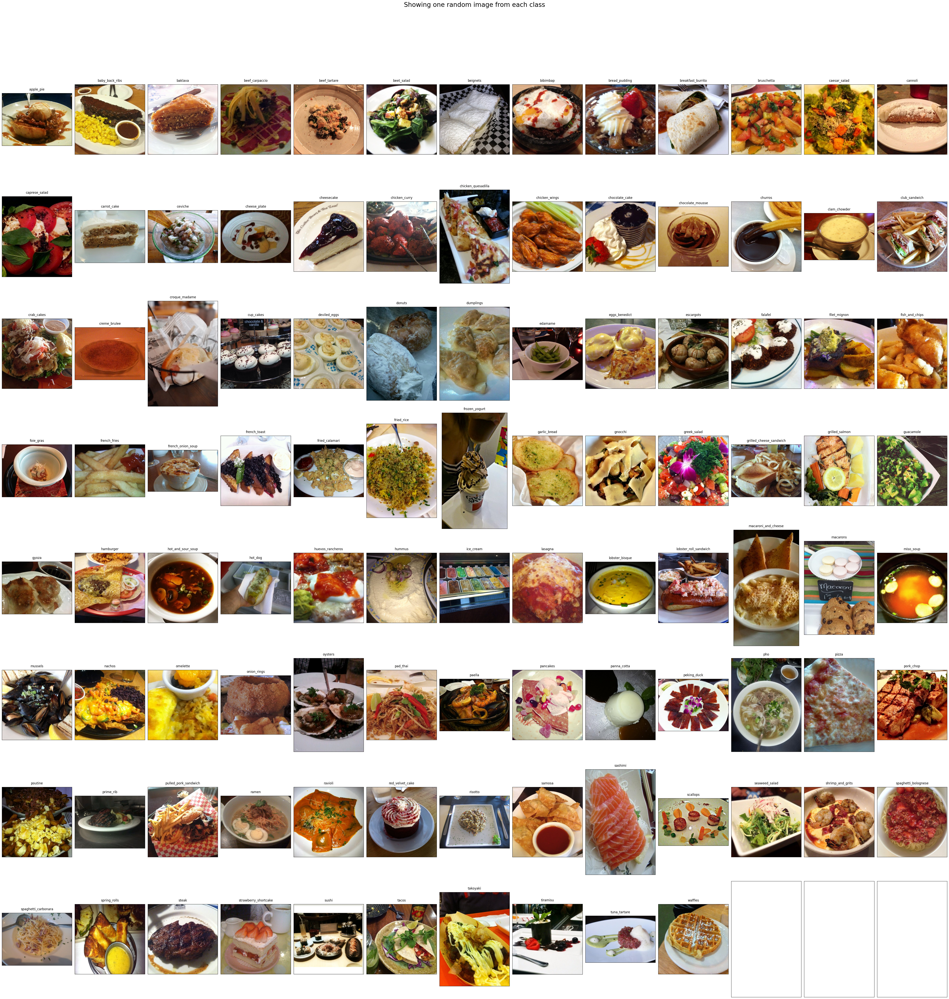

In [5]:
# Visualize the data, showing one image per class from 101 classes
rows = 8
cols = 13
fig, ax = plt.subplots(rows, cols, figsize=(50,50))
fig.suptitle("Showing one random image from each class", y=1.05, fontsize=24) # Adding  y=1.05, fontsize=24 helped me fix the suptitle overlapping with axes issue
data_dir = "/kaggle/input/foodimages/food-101/images"
foods_sorted = sorted(os.listdir(data_dir))
food_id = 0
for i in range(rows):
  for j in range(cols):
    try:
      food_selected = foods_sorted[food_id] 
      food_id += 1
    except:
      break
    food_selected_images = os.listdir(os.path.join(data_dir,food_selected)) # returns the list of all files present in each food category
    food_selected_random = np.random.choice(food_selected_images) # picks one food item from the list as choice, takes a list and returns one random item
    img = plt.imread(os.path.join(data_dir,food_selected, food_selected_random))
    ax[i][j].imshow(img)
    ax[i][j].set_title(food_selected, pad = 10)
    
plt.setp(ax, xticks=[],yticks=[])
plt.tight_layout()

In [6]:
# Let's use a Inceptionv3 model on subset of data with 101 food classes

K.clear_session()
batch_size=128

n_classes = 101
img_width, img_height = 299, 299
train_data_dir = "/kaggle/input/foodimages/food-101/images"


train_datagen = ImageDataGenerator(
    rescale=1. / 255,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    validation_split=0.2
    )


train_generator = train_datagen.flow_from_directory(
    train_data_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    subset='training')

validation_generator = train_datagen.flow_from_directory(
    train_data_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    subset='validation')

Found 80800 images belonging to 101 classes.
Found 20200 images belonging to 101 classes.


In [10]:
from tensorflow.keras.callbacks import ModelCheckpoint, CSVLogger

# Use `.keras` for checkpointing during training
checkpointer = ModelCheckpoint(filepath='best_model_class.keras', verbose=1, save_best_only=True)
csv_logger = CSVLogger('history.log')

history_class = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // batch_size,
    epochs=10,
    verbose=1,
    callbacks=[csv_logger, checkpointer]
)

# Manually save the final model as `.h5`
model.save('model_trained_101_class.h5')


Epoch 1/10
631/631 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - accuracy: 0.2796 - loss: 2.9013
Epoch 1: val_loss improved from inf to 2.16119, saving model to best_model_class.keras
631/631 ━━━━━━━━━━━━━━━━━━━━ 3189s 5s/step - accuracy: 0.2797 - loss: 2.9010 - val_accuracy: 0.4520 - val_loss: 2.1612
Epoch 2/10
  1/631 ━━━━━━━━━━━━━━━━━━━━ 4:40 445ms/step - accuracy: 0.3594 - loss: 2.5990

/opt/conda/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-11-02 05:18:52.889199: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng2{k2=3,k3=0} for conv (f32[104,192,71,71]{3,2,1,0}, u8[0]{0}) custom-call(f32[104,80,73,73]{3,2,1,0}, f32[192,80,3,3]{3,2,1,0}), window={size=3x3}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convForward", backend_config={"operation_queue_id":"0","wait_on_operation_queues":[],"cudnn_conv_backend_config":{"conv_result_scale":1,"activation_mode":"kNone","side_input_scale":0,"leakyrelu_alpha":0}} is taking a while...
2024-11-02 05:18:52.916553: E external/local_xla/xla/service/slow_operation_alarm.cc:133] The operation took 1.0275034s
Trying algorithm eng


Epoch 2: val_loss improved from 2.16119 to 2.15195, saving model to best_model_class.keras
631/631 ━━━━━━━━━━━━━━━━━━━━ 34s 52ms/step - accuracy: 0.3594 - loss: 2.5990 - val_accuracy: 0.4615 - val_loss: 2.1519
Epoch 3/10
631/631 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.3870 - loss: 2.3993
Epoch 3: val_loss improved from 2.15195 to 1.99312, saving model to best_model_class.keras
631/631 ━━━━━━━━━━━━━━━━━━━━ 2660s 4s/step - accuracy: 0.3870 - loss: 2.3992 - val_accuracy: 0.4886 - val_loss: 1.9931
Epoch 4/10
  1/631 ━━━━━━━━━━━━━━━━━━━━ 4:38 442ms/step - accuracy: 0.4453 - loss: 2.2393
Epoch 4: val_loss did not improve from 1.99312
631/631 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - accuracy: 0.4453 - loss: 2.2393 - val_accuracy: 0.4327 - val_loss: 2.2044
Epoch 5/10
631/631 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.4276 - loss: 2.2394
Epoch 5: val_loss improved from 1.99312 to 1.92190, saving model to best_model_class.keras
631/631 ━━━━━━━━━━━━━━━━━━━━ 2641s 4s/step - accuracy: 0.4276 - 

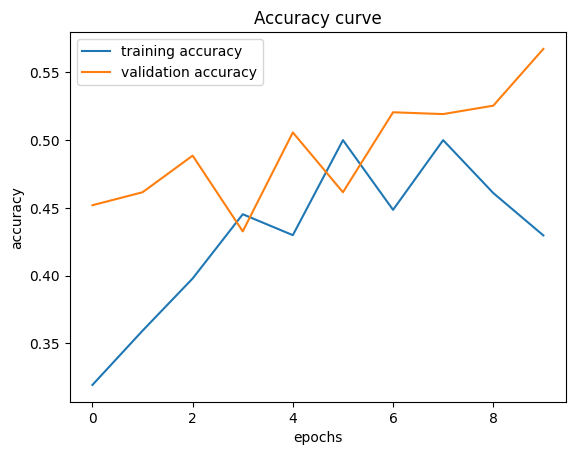

In [11]:
history=history_class
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
epochs = range(len(acc))

plt.plot(acc, label='training accuracy')
plt.plot(val_acc, label='validation accuracy')
plt.title('Accuracy curve')
plt.xlabel('epochs')
plt.ylabel('accuracy')
plt.legend()

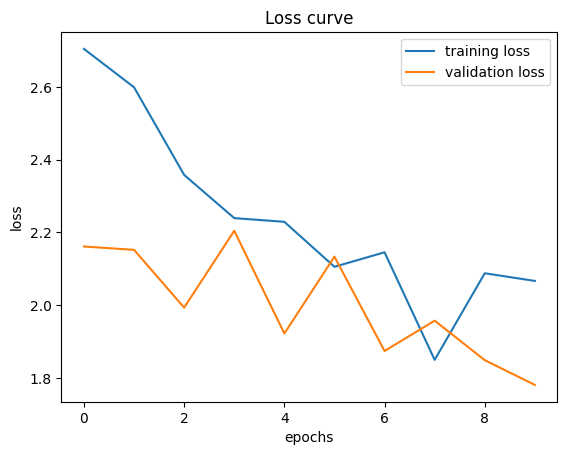

In [12]:
loss = history.history['loss']
val_loss = history.history['val_loss']

plt.plot(loss, label='training loss')
plt.plot(val_loss, label='validation loss')
plt.title('Loss curve')
plt.xlabel('epochs')
plt.ylabel('loss')
plt.legend()

In [13]:
from tensorflow.keras.models import load_model
model_best = load_model('/kaggle/working/model_trained_101_class.h5', compile=False)

In [14]:
# Downloading images from internet using the URLs
!wget -O frenchfries.jpg https://www.dirtyapronrecipes.com/wp-content/uploads/2017/03/french-fries.jpg
!wget -O chocolatecake.jpg https://tastesbetterfromscratch.com/wp-content/uploads/2010/06/Hersheys-Perfectly-Chocolate-Chocolate-Cake-13.jpg
!wget -O waffles.jpg https://upload.wikimedia.org/wikipedia/commons/5/5b/Waffles_with_Strawberries.jpg
!wget -O applepie.jpg https://www.theseasonedmom.com/wp-content/uploads/2018/08/Moms-Easy-Apple-Pie-10-500x375.jpg

/opt/conda/lib/python3.10/pty.py:89: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


--2024-11-02 08:21:39--  https://www.dirtyapronrecipes.com/wp-content/uploads/2017/03/french-fries.jpg
Resolving www.dirtyapronrecipes.com (www.dirtyapronrecipes.com)... 162.241.217.105
Connecting to www.dirtyapronrecipes.com (www.dirtyapronrecipes.com)|162.241.217.105|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 94134 (92K) [image/jpeg]
Saving to: 'frenchfries.jpg'

frenchfries.jpg     100%[===================>]  91.93K  --.-KB/s    in 0.07s   

2024-11-02 08:21:39 (1.23 MB/s) - 'frenchfries.jpg' saved [94134/94134]

--2024-11-02 08:21:40--  https://tastesbetterfromscratch.com/wp-content/uploads/2010/06/Hersheys-Perfectly-Chocolate-Chocolate-Cake-13.jpg
Resolving tastesbetterfromscratch.com (tastesbetterfromscratch.com)... 104.18.5.29, 104.18.4.29, 2606:4700::6812:41d, ...
Connecting to tastesbetterfromscratch.com (tastesbetterfromscratch.com)|104.18.5.29|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 32401 (32K) [image/jpeg]
Sav

In [15]:

food_list=['apple_pie', 'baby_back_ribs', 'baklava', 'beef_carpaccio', 'beef_tartare', 'beet_salad', 'beignets', 'bibimbap', 'bread_pudding', 'breakfast_burrito', 'bruschetta', 'caesar_salad', 'cannoli', 'caprese_salad', 'carrot_cake', 'ceviche', 'cheese_plate', 'cheesecake', 'chicken_curry', 'chicken_quesadilla', 'chicken_wings', 'chocolate_cake', 'chocolate_mousse', 'churros', 'clam_chowder', 'club_sandwich', 'crab_cakes', 'creme_brulee', 'croque_madame', 'cup_cakes', 'deviled_eggs', 'donuts', 'dumplings', 'edamame', 'eggs_benedict', 'escargots', 'falafel', 'filet_mignon', 'fish_and_chips', 'foie_gras', 'french_fries', 'french_onion_soup', 'french_toast', 'fried_calamari', 'fried_rice', 'frozen_yogurt', 'garlic_bread', 'gnocchi', 'greek_salad', 'grilled_cheese_sandwich', 'grilled_salmon', 'guacamole', 'gyoza', 'hamburger', 'hot_and_sour_soup', 'hot_dog', 'huevos_rancheros', 'hummus', 'ice_cream', 'lasagna', 'lobster_bisque', 'lobster_roll_sandwich', 'macaroni_and_cheese', 'macarons', 'miso_soup', 'mussels', 'nachos', 'omelette', 'onion_rings', 'oysters', 'pad_thai', 'paella', 'pancakes', 'panna_cotta', 'peking_duck', 'pho', 'pizza', 'pork_chop', 'poutine', 'prime_rib', 'pulled_pork_sandwich', 'ramen', 'ravioli', 'red_velvet_cake', 'risotto', 'samosa', 'sashimi', 'scallops', 'seaweed_salad', 'shrimp_and_grits', 'spaghetti_bolognese', 'spaghetti_carbonara', 'spring_rolls', 'steak', 'strawberry_shortcake', 'sushi', 'tacos', 'takoyaki', 'tiramisu', 'tuna_tartare', 'waffles']
food_list.sort()

In [16]:
from tensorflow.keras.preprocessing import image
import matplotlib.pyplot as plt
import numpy as np
import os

def predict_class(model, images, show = True):
  for img in images:
    img = image.load_img(img, target_size=(299, 299))
    img = image.img_to_array(img)                    
    img = np.expand_dims(img, axis=0) #tensor-n dimen  4      
    img /= 255.                                      
    #global pred
    pred = model_best.predict(img)
    index = np.argmax(pred)
    food_list.sort()
    pred_value = food_list[index]
    if show:
        plt.imshow(img[0])                           
        plt.axis('off')
        plt.title(pred_value)
        plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 7s 7s/step


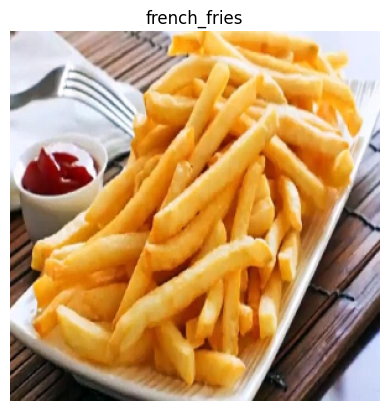

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


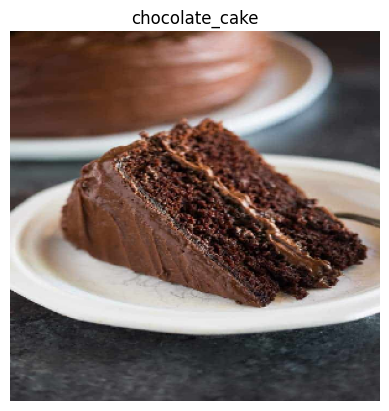

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


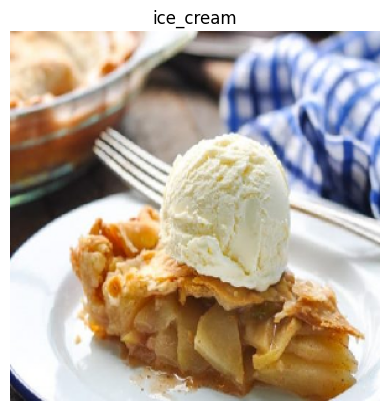

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


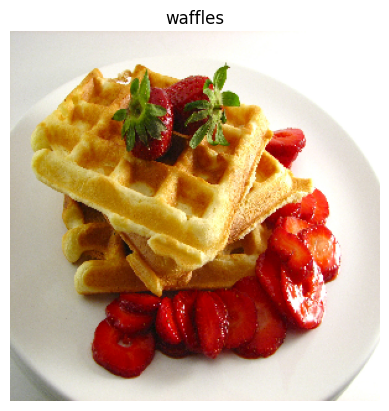

In [17]:
# Make a list of downloaded images and test the trained model
images = []
images.append('frenchfries.jpg')
images.append('chocolatecake.jpg')
images.append('applepie.jpg')
images.append('waffles.jpg')
predict_class(model_best, images, True)

In [19]:
pred_value=[]
gnd_truth=[]
import os
from tensorflow.keras.preprocessing import image
import numpy as np
for dirname, _, filenames in os.walk('/content/food-101/images/'):
  for filename in filenames:
    imgpath=dirname+'/'+filename
    #print(imgpath)
    img = image.load_img(imgpath, target_size=(299, 299))
    img = image.img_to_array(img)
                  
    img = np.expand_dims(img, axis=0)         
    img = img/255                                      #

    pred = model_best.predict(img)
    index = np.argmax(pred)
    pred_value.append(food_list[index])
    gnd_truth.append(dirname.split('/')[4])
    print(food_list[index])
    # print(dirname.split('/')[4])